In [1]:
import pickle
import os
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.patches import Polygon
%matplotlib inline 
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [2]:
def camera_calibration(calibration_images, nx, ny):
    '''Camera calibration function'''
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((ny*nx,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)
# Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    for img_num,fname in enumerate(calibration_images):
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
    # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
    # Do camera calibration given object points and image points
    img_size = (img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    return ret, mtx, dist, rvecs, tvecs

In [3]:
def plot_image_set(images, titles, image_type=None):
    '''function to plot images of different steps'''
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(images[0],cmap=image_type)
    ax1.set_title(titles[0], fontsize=50)
    
    ax2.imshow(images[1],cmap=image_type)
    ax2.set_title(titles[1], fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


##      Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [4]:
# computed the camera matrix and distortion coefficients.
calibration_images = glob.glob('camera_cal/calibration*.jpg')
ret, mtx, dist, rvecs, tvecs = camera_calibration(calibration_images,9,6)
#Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle.p", "wb" ) )
# loop through all the calibration images and undistort each image
for img_num,fname in enumerate(calibration_images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    #plot_image_set([img, dst], ['Original Image', 'Undistorted Image'], image_type=None)
    #Saving each undistorted calibration image
    file_name = 'undistorted_calibration'+str(img_num)+'.jpg'
    cv2.imwrite(os.path.join('camera_cal/', file_name), cv2.cvtColor(dst, cv2.COLOR_RGB2BGR))

## Test Images: from original to undistorted

In [5]:
test_images = glob.glob('test_images/test*.jpg')
for img_num,fname in enumerate(test_images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    #plot_image_set([img, dst], ['Original Image', 'Undistorted Image'], image_type=None)
    #Saving each undistorted calibration image
    file_name = 'undistorted_calibration'+str(img_num)+'.jpg'
    cv2.imwrite(os.path.join('test_images/', file_name), cv2.cvtColor(dst, cv2.COLOR_RGB2BGR))
   

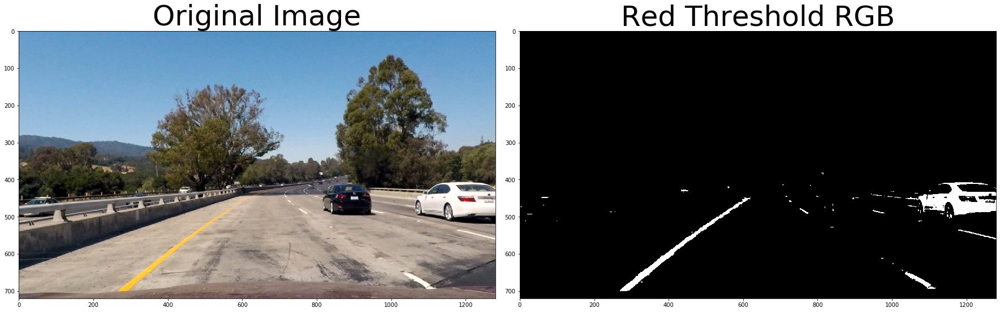

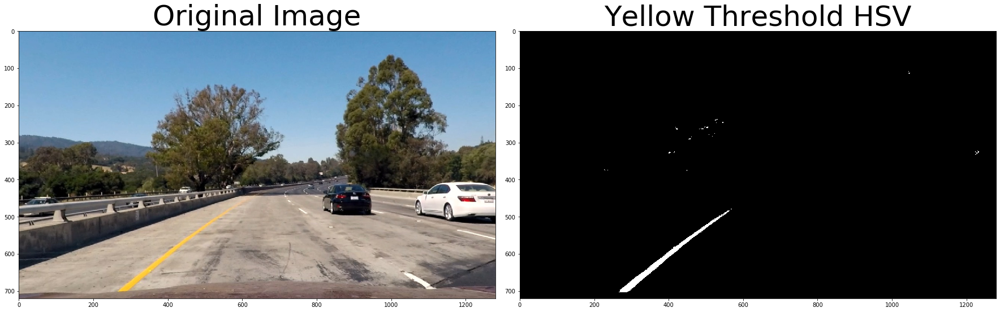

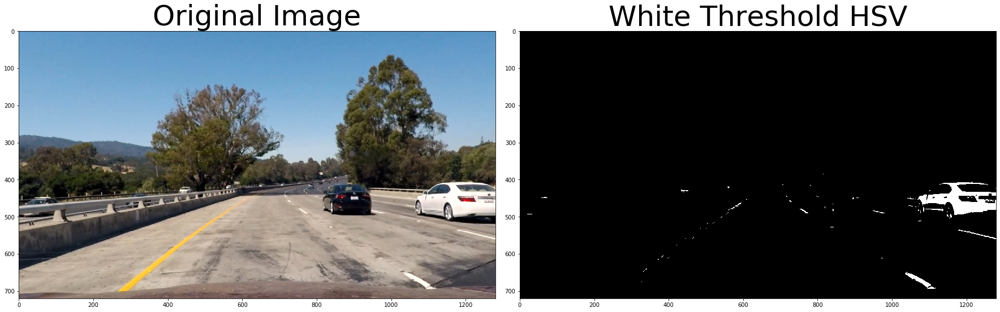

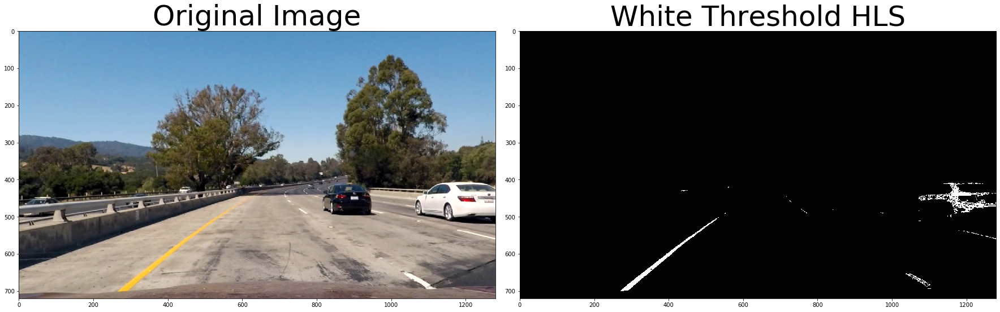

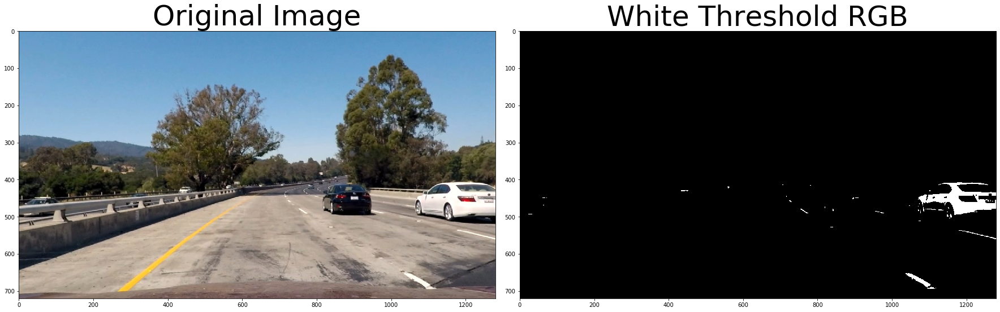

...

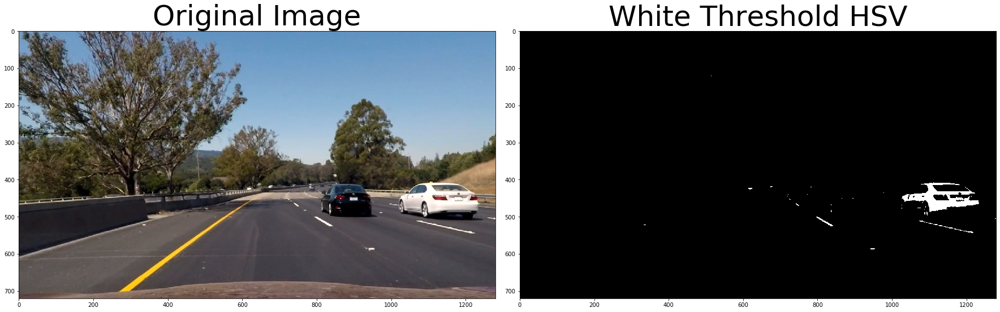

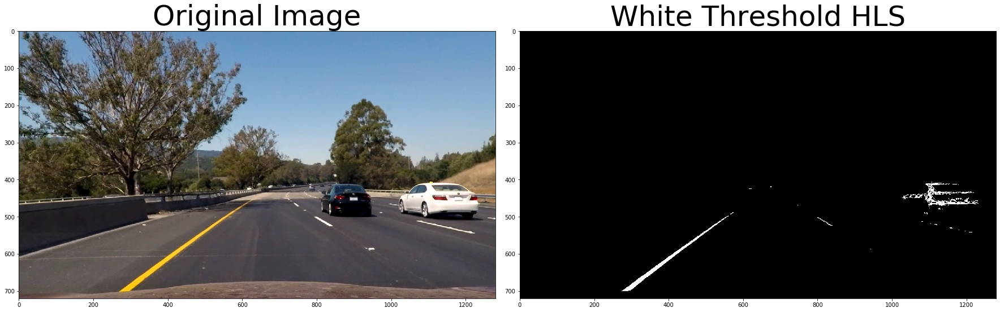

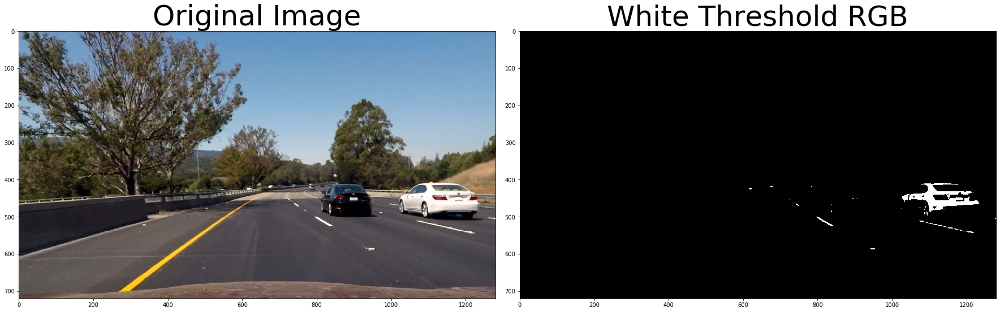

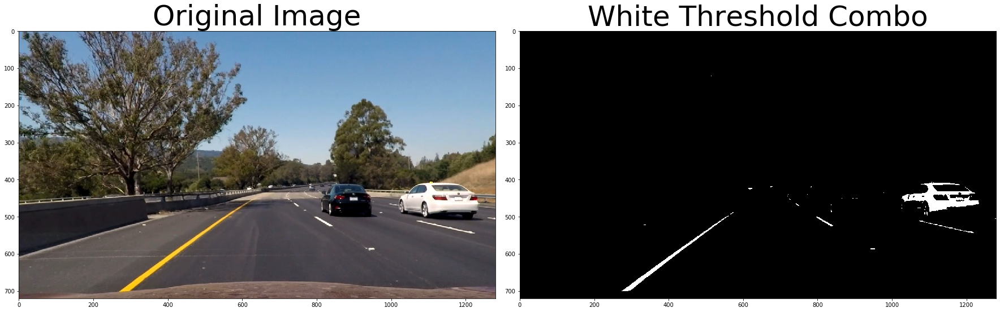

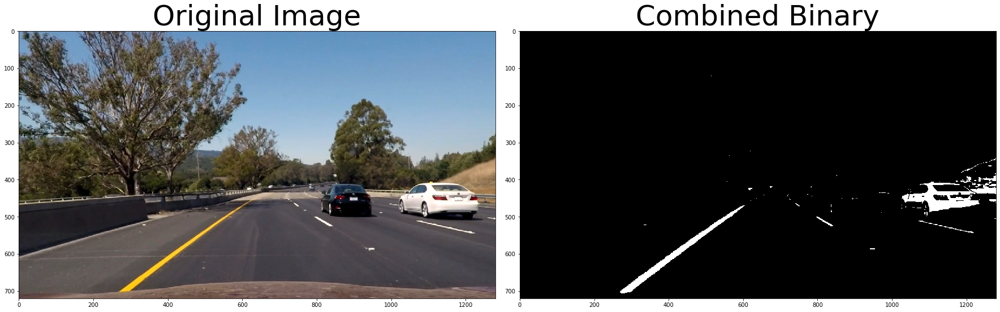

In [6]:
def red_threshold(image, plot=False):
    red_channel = image[:,:,0]
    min_thresh = 220
    max_thresh = 255
    _, red_thresh = cv2.threshold(red_channel, min_thresh, max_thresh, cv2.THRESH_BINARY)
    if plot:
        plot_image_set([image, red_thresh], titles=['Original Image', 'Red Threshold RGB'], image_type='gray')
    return red_thresh

def yellow_threshold_hsv(image, plot=False):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    hsv_thresh_min_yellow = (10, 110, 110)
    hsv_thresh_max_yellow = (40, 255, 255)
    yellow_line = cv2.inRange(hsv_image, hsv_thresh_min_yellow, hsv_thresh_max_yellow)
    if plot:
        plot_image_set([image, yellow_line], titles=['Original Image', 'Yellow Threshold HSV'], image_type='gray')
    return yellow_line


def white_combo(image, plot=False):
    
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    hsv_thresh_min_white = (0, 0, 230)
    hsv_thresh_max_white = (200,100, 255)
    white_line_hsv = cv2.inRange(hsv_image, hsv_thresh_min_white, hsv_thresh_max_white)

    hls_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    hls_thresh_min_white = (0, 100, 230)
    hls_thresh_max_white = (200, 255, 255)
    white_line_hls = cv2.inRange(hls_image, hls_thresh_min_white, hls_thresh_max_white)

    rgb_thresh_min_white = (220,220,220)
    rgb_thresh_max_white = (255,255,255)
    white_line_rgb = cv2.inRange(image, rgb_thresh_min_white, rgb_thresh_max_white)

    white_line_combo = white_line_hsv | white_line_hls | white_line_rgb
    
    if plot:
        plot_image_set([image, white_line_hsv], titles=['Original Image', 'White Threshold HSV'], image_type='gray')
        plot_image_set([image, white_line_hls], titles=['Original Image', 'White Threshold HLS'], image_type='gray')
        plot_image_set([image, white_line_rgb], titles=['Original Image', 'White Threshold RGB'], image_type='gray')
        plot_image_set([image, white_line_combo], titles=['Original Image', 'White Threshold Combo'], image_type='gray')
        
    return  white_line_hsv, white_line_hls, white_line_rgb, white_line_combo

        

def color_combo(image, plot = False):
    red_thresh = red_threshold(image, plot=plot)
    yellow_line = yellow_threshold_hsv(image, plot=plot)
    white_line_hsv, white_line_hls, white_line_rgb, white_line_combo = white_combo(image, plot = plot)
    combined_binary =  red_thresh | yellow_line | white_line_combo
    if plot:
        plot_image_set([image, combined_binary], titles=['Original Image', 'Combined Binary'], image_type='gray')
    return combined_binary

test_images = glob.glob('test_images/test*.jpg')
for img_num,fname in enumerate(test_images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    combined_binary = color_combo(dst, plot = True)

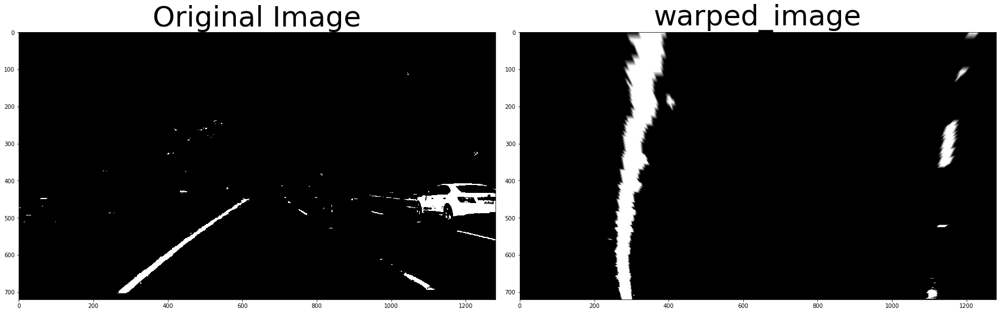

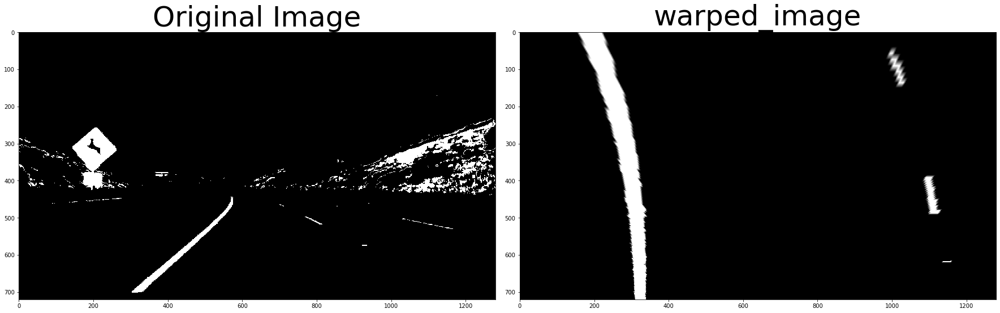

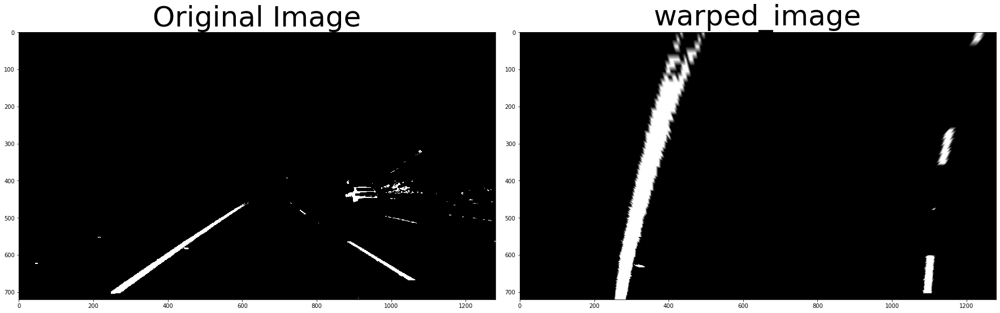

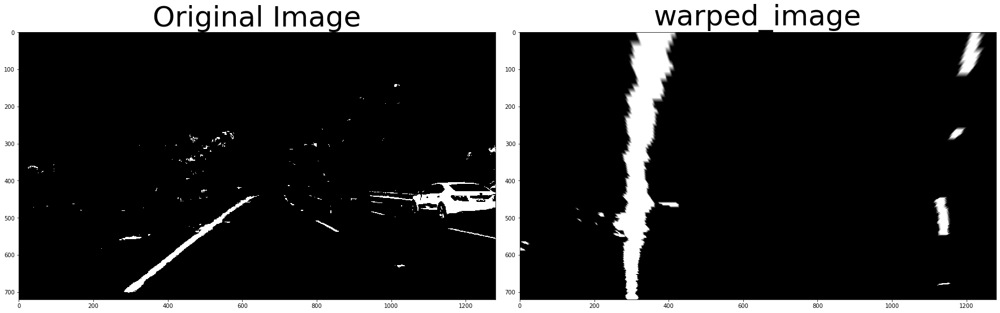

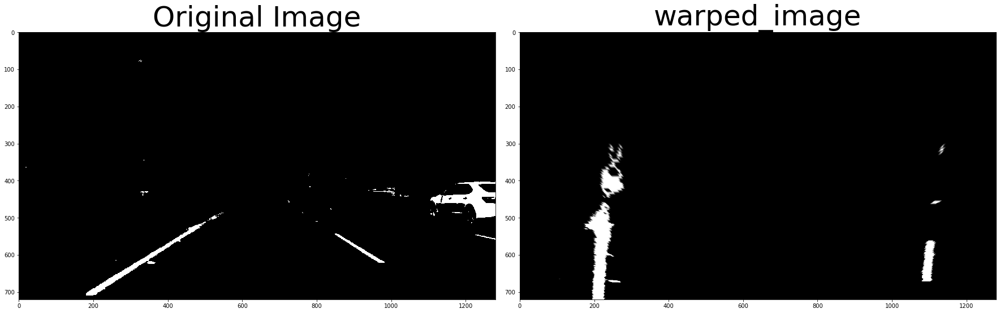

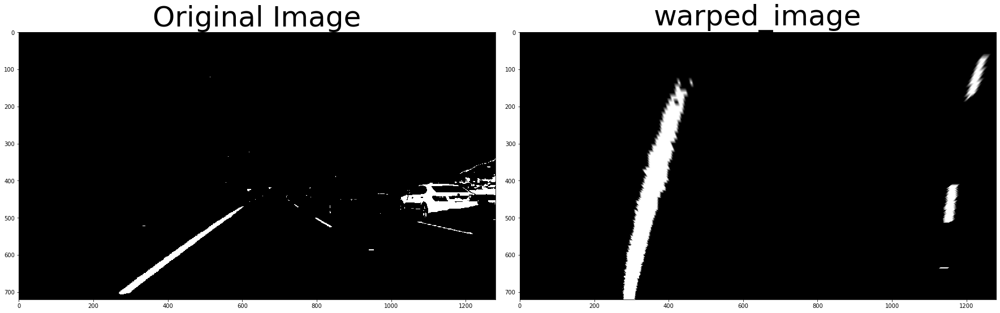

In [7]:
def transform_prespective(image, plot = False):
    img_size = (image.shape[1], image.shape[0])
    src = np.float32([[240,700],[580,460],[705,460],[1080,700]])
    dst = np.float32([[250,720],[250,0],[1065,0],[1065,720]])
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped_image = cv2.warpPerspective(image,M, img_size)
    if plot:
        plot_image_set([image, warped_image], titles=['Original Image', 'warped_image'], image_type='gray')
    return warped_image

test_images = glob.glob('test_images/test*.jpg')
for img_num,fname in enumerate(test_images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    combined_binary = color_combo(dst, plot = False)
    warped_image = transform_prespective(combined_binary, plot = True)

In [8]:
def transform_prespective_to_road_view(image, plot = False):
    ''' #Warp the bird eye perspective image back to original image space using inverse perspective matrix (Minv)'''
    img_size = (image.shape[1], image.shape[0])
    src = np.float32([[240,700],[580,460],[705,460],[1080,700]])
    dst = np.float32([[250,720],[250,0],[1065,0],[1065,720]])
    Minv = cv2.getPerspectiveTransform(dst, src)
    unwarped_image = cv2.warpPerspective(image, Minv, (image.shape[1], image.shape[0])) 
    if plot:
        plot_image_set([image, unwarped_image], titles=['Original Image', 'unwarped_image'], image_type='gray')
    return unwarped_image


## Helper functions to find the lanes

In [9]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit

In [10]:
def search_around_poly(binary_warped,left_fit,right_fit):
    '''search a margin around the previous lane line position'''
    margin = 100
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### Set the area of search based on activated x-values ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    return left_fit, right_fit

In [11]:
def measure_distance_curvature_real(image,left_fit,right_fit,left_fitx,right_fitx,ploty):
    '''
    Calculates the curvature of polynomial functions in meters and the car distance from the centre
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    image_height, image_width = image.shape[0], image.shape[1]
    car_position= image.shape[1]/2
    # Define y-value where we want radius of curvature
    y_eval = np.max(ploty)
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    radius_of_curvature = (left_curverad + right_curverad)/2     
    # Calculating the car position
    left_lane_bottom = left_fit[0]*image_height**2 + left_fit[1]*image_height + left_fit[2]
    right_lane_bottom = right_fit[0]*image_height**2 + right_fit[1]*image_height + right_fit[2]
    actual_position = (left_lane_bottom+ right_lane_bottom)/2
    distance = abs((car_position - actual_position)* xm_per_pix)
    if distance < image_width/2:
        distance_type = 'left'
    else:
        distance_type = 'right'
    return radius_of_curvature,distance,distance_type



In [12]:
def draw_poly(image, left_fit, right_fit):
    
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0])
    
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty 
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(image).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    final_image = cv2.fillPoly(warp_zero , np.int_([pts]), (0,255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    radius_of_curvature, distance, distance_type = measure_distance_curvature_real(final_image,left_fit,right_fit,left_fitx,right_fitx,ploty)
    return  final_image, radius_of_curvature, distance, distance_type

In [13]:
def polygon_area(image, left_fit=None, right_fit=None, video_mode=False, plot=False):
    if video_mode:
        if not left_fit or not right_fit:
            left_fit, right_fit = find_lane_pixels(image)
        else:
            left_fit, right_fit = search_around_poly(image, left_fit, right_fit)
    else:
        left_fit, right_fit = find_lane_pixels(image)
    warp_zero = np.zeros_like(image).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    polygon_image, radius_of_curvature, distance, distance_type = draw_poly(color_warp, left_fit, right_fit)
    
    return polygon_image, radius_of_curvature, distance, distance_type

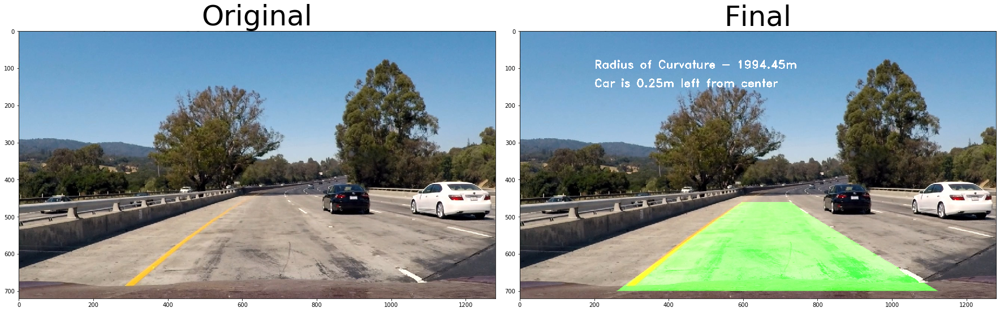

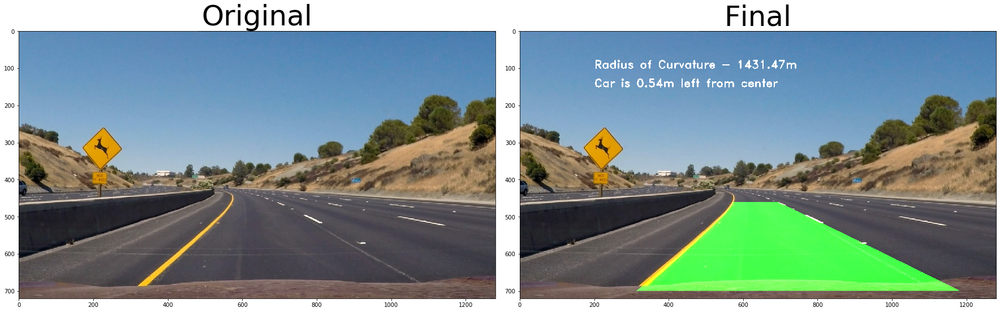

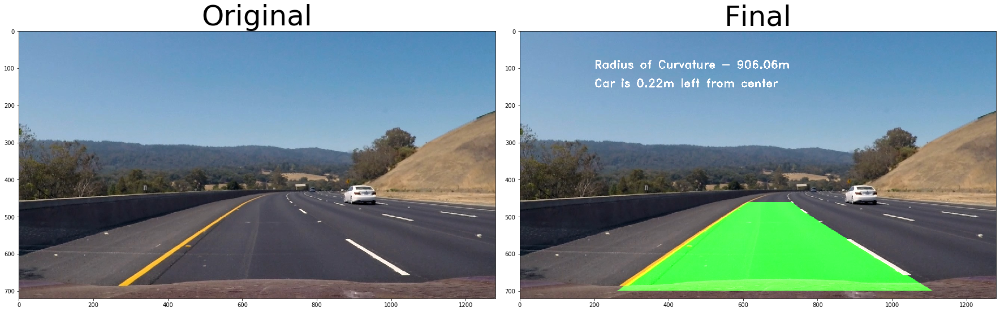

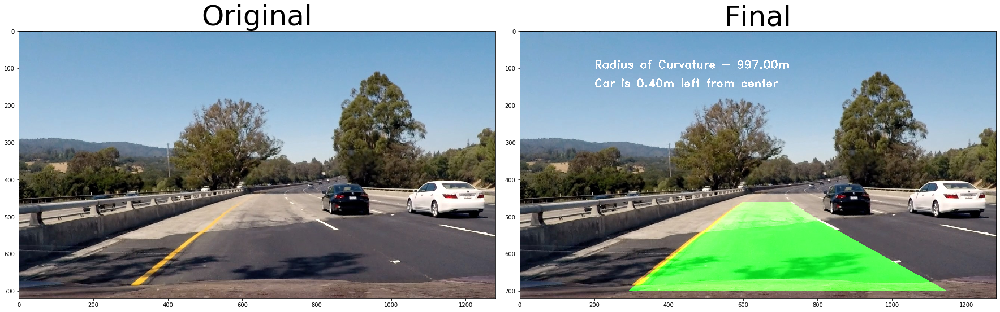

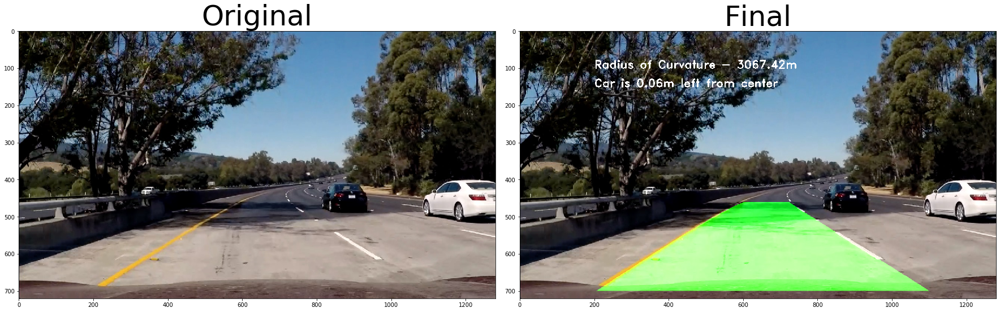

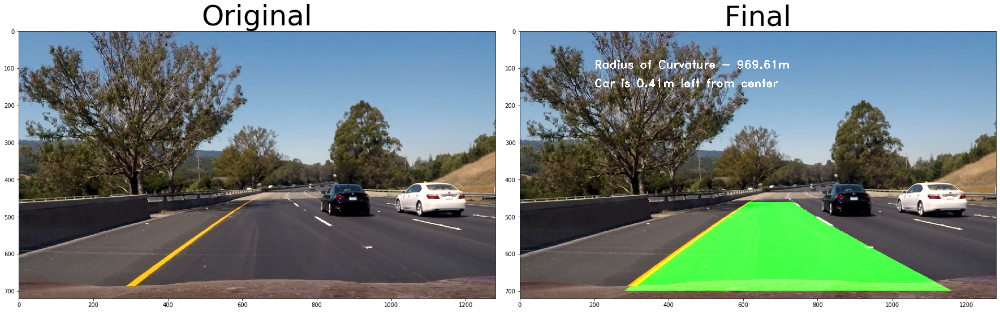

In [14]:
test_images = glob.glob('test_images/test*.jpg')
for img_num,fname in enumerate(test_images):
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    combined_binary = color_combo(dst, plot = False)
    warped_image = transform_prespective(combined_binary, plot = False)
    poly_image_perspective, radius_of_curvature,distance, distance_type = polygon_area(warped_image, 
                                left_fit=None, right_fit=None, video_mode=False, plot=False)
    poly_image_road_view = transform_prespective_to_road_view(poly_image_perspective, plot= False)                                                               
    weighted_image = cv2.addWeighted(img, 1, poly_image_road_view, 0.8, 0)
    cv2.putText(weighted_image, "Radius of Curvature - {:.2f}m".format(radius_of_curvature), (200, 100), cv2.FONT_HERSHEY_DUPLEX, 1, (255,255,255), 2)
    cv2.putText(weighted_image, "Car is {:.2f}m {} from center".format(distance,distance_type), (200, 150), cv2.FONT_HERSHEY_DUPLEX, 1, (255,255,255), 2)                                                               
    plot_image_set([img, weighted_image], titles=['Original', 'Final'])
    plt.imsave('output_images/'+ 'test' + str(img_num)+'.jpg', weighted_image)


In [15]:
def process_image(img):
    try:
        dst = cv2.undistort(img, mtx, dist, None, mtx)
        combined_binary = color_combo(dst, plot = False)
        warped_image = transform_prespective(combined_binary, plot = False)
        poly_image_perspective, radius_of_curvature,distance, distance_type = polygon_area(warped_image, 
                                left_fit=None, right_fit=None, video_mode=True, plot=False)
        poly_image_road_view = transform_prespective_to_road_view(poly_image_perspective, plot= False)                                                               
        weighted_image = cv2.addWeighted(img, 1, poly_image_road_view, 0.8, 0)
        cv2.putText(weighted_image, "Radius of Curvature - {:.2f}m".format(radius_of_curvature), (200, 100), cv2.FONT_HERSHEY_DUPLEX, 1, (255,255,255), 2)
        cv2.putText(weighted_image, "Car is {:.2f}m {} from center".format(distance,distance_type), (200, 150), cv2.FONT_HERSHEY_DUPLEX, 1, (255,255,255), 2)    
    except Exception as ex:
        print(ex)
        return img
    return weighted_image

In [16]:
project_video = 'test_videos_output/project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(project_video, audio=False)

Moviepy - Building video test_videos_output/project_video.mp4.
Moviepy - Writing video test_videos_output/project_video.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output/project_video.mp4
Wall time: 3min 1s


In [17]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_video))

In [18]:
challenge_video = 'test_videos_output/challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("challenge_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(challenge_video, audio=False)

Moviepy - Building video test_videos_output/challenge_video.mp4.
Moviepy - Writing video test_videos_output/challenge_video.mp4



t:   1%|▉                                                                    | 7/485 [00:00<01:04,  7.37it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:   2%|█▎                                                                   | 9/485 [00:01<00:57,  8.30it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:   2%|█▌                                                                  | 11/485 [00:01<00:51,  9.13it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:   3%|█▊                                                                  | 13/485 [00:01<00:47, 10.00it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:   3%|██                                                                  | 15/485 [00:01<00:44, 10.62it/s, now=None]

expected non-empty vector for x


t:   4%|██▉                                                                 | 21/485 [00:02<00:48,  9.55it/s, now=None]

expected non-empty vector for x


t:  13%|████████▉                                                           | 64/485 [00:07<00:55,  7.65it/s, now=None]

expected non-empty vector for x


t:  27%|██████████████████▎                                                | 133/485 [00:16<00:45,  7.82it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  28%|██████████████████▋                                                | 135/485 [00:16<00:40,  8.65it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  28%|██████████████████▉                                                | 137/485 [00:16<00:36,  9.41it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  29%|███████████████████▏                                               | 139/485 [00:16<00:34, 10.10it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  29%|███████████████████▍                                               | 141/485 [00:17<00:32, 10.65it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  29%|███████████████████▊                                               | 143/485 [00:17<00:31, 10.96it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  30%|████████████████████                                               | 145/485 [00:17<00:30, 11.16it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  30%|████████████████████▎                                              | 147/485 [00:17<00:29, 11.48it/s, now=None]

expected non-empty vector for x


t:  50%|█████████████████████████████████▌                                 | 243/485 [00:29<00:31,  7.61it/s, now=None]

expected non-empty vector for x


t:  51%|█████████████████████████████████▊                                 | 245/485 [00:30<00:29,  8.06it/s, now=None]

expected non-empty vector for x


t:  61%|█████████████████████████████████████████▏                         | 298/485 [00:37<00:23,  7.88it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  62%|█████████████████████████████████████████▍                         | 300/485 [00:37<00:21,  8.69it/s, now=None]

expected non-empty vector for x


t:  62%|█████████████████████████████████████████▊                         | 303/485 [00:37<00:21,  8.63it/s, now=None]

expected non-empty vector for x


t:  67%|█████████████████████████████████████████████                      | 326/485 [00:40<00:20,  7.86it/s, now=None]

expected non-empty vector for x


t:  70%|██████████████████████████████████████████████▉                    | 340/485 [00:42<00:18,  7.98it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  96%|████████████████████████████████████████████████████████████████▏  | 465/485 [00:58<00:02,  7.46it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  99%|██████████████████████████████████████████████████████████████████▏| 479/485 [00:59<00:00,  7.52it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  99%|██████████████████████████████████████████████████████████████████▍| 481/485 [01:00<00:00,  8.40it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


Moviepy - Done !
Moviepy - video ready test_videos_output/challenge_video.mp4
Wall time: 1min 1s


In [19]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_video))

In [20]:
harder_challenge_video = 'test_videos_output/harder_challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("harder_challenge_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(harder_challenge_video, audio=False)

Moviepy - Building video test_videos_output/harder_challenge_video.mp4.
Moviepy - Writing video test_videos_output/harder_challenge_video.mp4



t:  49%|████████████████████████████████▍                                 | 590/1199 [01:33<01:20,  7.61it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  49%|████████████████████████████████▌                                 | 592/1199 [01:34<01:10,  8.57it/s, now=None]

expected non-empty vector for x


t:  50%|█████████████████████████████████                                 | 601/1199 [01:35<01:17,  7.74it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  50%|█████████████████████████████████▏                                | 603/1199 [01:35<01:08,  8.69it/s, now=None]

expected non-empty vector for x


t:  50%|█████████████████████████████████▎                                | 605/1199 [01:35<01:08,  8.72it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  51%|█████████████████████████████████▍                                | 607/1199 [01:35<01:03,  9.38it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  51%|█████████████████████████████████▌                                | 609/1199 [01:35<00:59,  9.98it/s, now=None]

expected non-empty vector for x


t:  59%|██████████████████████████████████████▊                           | 705/1199 [01:53<01:06,  7.44it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  77%|██████████████████████████████████████████████████▋               | 921/1199 [02:29<00:37,  7.34it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  77%|██████████████████████████████████████████████████▊               | 923/1199 [02:29<00:33,  8.29it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  77%|██████████████████████████████████████████████████▉               | 925/1199 [02:29<00:30,  9.07it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  77%|███████████████████████████████████████████████████               | 927/1199 [02:29<00:29,  9.31it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  77%|███████████████████████████████████████████████████▏              | 929/1199 [02:30<00:27,  9.88it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  78%|███████████████████████████████████████████████████▏              | 931/1199 [02:30<00:28,  9.37it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  78%|███████████████████████████████████████████████████▎              | 933/1199 [02:30<00:26,  9.88it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  78%|███████████████████████████████████████████████████▍              | 935/1199 [02:30<00:26,  9.93it/s, now=None]

expected non-empty vector for x


t:  78%|███████████████████████████████████████████████████▋              | 940/1199 [02:31<00:33,  7.76it/s, now=None]

expected non-empty vector for x


t:  84%|██████████████████████████████████████████████████████▉          | 1013/1199 [02:41<00:24,  7.57it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  85%|███████████████████████████████████████████████████████          | 1015/1199 [02:41<00:21,  8.47it/s, now=None]

expected non-empty vector for x
expected non-empty vector for x


t:  85%|███████████████████████████████████████████████████████▏         | 1017/1199 [02:41<00:19,  9.24it/s, now=None]

expected non-empty vector for x


Moviepy - Done !
Moviepy - video ready test_videos_output/harder_challenge_video.mp4
Wall time: 3min 12s


In [21]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_video))